In [1]:
import matplotlib.pyplot as plt
import pickle
import numpy as np
import random
import rebound

G = 6.67408*10**(-11)   # gravitational constant
Mearth = 5.9722*10**24  # kg
Rearth = 6.371*10**6  # meters
Msun = 1.98911*10**30 # kg
Rsun = 6.95*10**8 # meters
Mjup = 1.898*10**27  # kg
Rjup = 7.1492*10**7 # meters
year = 365.25*24*60*60  # years in seconds
AU = (G*Msun*(year**2)/(4.*np.pi**2))**(1./3.)  # meters


In [2]:
# SIMULATION SETUP

# FOR THE ARGUMENTS FOR THE TEMPLATE FUNCTIONS: roughly 2-3 collisiosn between inner systems sum to the inner planet of TOI-969
# ALSO: Use of SPOCK for narrowing down templates. Draw randomly from inner + outer and then do a SPOCK: if stable, quit
# SPOCK also has instability time estimator

globala = []
globalm = []

def inner_template(n,m,a):
    sim = rebound.Simulation()
    sim.integrator = "mercurius"
    #sim.G = 6.6743e-11 # m^3 / kg s^2
    #sim.exit_max_distance = 500 * AU
    # sim.dt = 0.00547570157 / 20
    sim.ri_mercurius.safe_mode = 0 # turning safe mode off
    sim.ri_mercurius.hillfrac = 5
    sim.ri_whfast.safe_mode = 0 # turning whfast safe mode off
    # same as outer template!
    Mp_out = np.random.normal(m, m/4) * Mearth
    Mstar = 1*Msun
    sim.add(m = Mstar/Msun)
    A = 0.5*(2*Mp_out/(3*Mstar))**(1./3)
    #K = np.random.uniform(8, 10) # maybe also draw K from some random distribution? e.g. 4 to 6
    K = 15
    a_iplus1_a_i = (1+K*A)/(1-K*A)
    a_list = np.zeros(n)
    m_list = np.zeros(n)
    r_list = np.zeros(n)
    e_list = np.zeros(n)
    omega_list = np.zeros(n)
    Omega_list = np.zeros(n)
    M_list = np.zeros(n)
    inc_list = np.zeros(n)
    a_list[round(n / 2) - 1] = np.random.normal(a, a/12)*(1-K*A)
    for i in range(round(n / 2) - 2, -1, -1):
#         print(i)
        a_list[i] = a_list[i + 1]/a_iplus1_a_i
    for i in range(round(n / 2), n):
        a_list[i] = a_list[i - 1]*a_iplus1_a_i
#     print(a_list)
    for i in range(n):
        m_list[i] = np.random.normal(m, m/4) * (Mearth/Msun)
        r_list[i] = 0.7 * m_list[i] ** (0.63) * (Rearth/AU)
        e_list[i] = e = np.random.rayleigh(scale = 0.035)
        omega_list[i] = random.uniform(0, 2 * np.pi)
        Omega_list[i] = random.uniform(0, 2 * np.pi)
        M_list[i] = random.uniform(0, 2 * np.pi)
        inc_list[i] = np.random.rayleigh(scale = 0.0175)
    for i in range(n):
        sim.add(m = m_list[i], 
                a = a_list[i], 
                hash = "inner_p" + str(i), 
                r = r_list[i], 
                e = e_list[i], 
                inc = inc_list[i], 
                omega = omega_list[i], 
                Omega = Omega_list[i], 
                M = M_list[i])
    for i in range(n):
        globala.append(a_list[i])
        globalm.append(m_list[i])
    ps = sim.particles
    return sim
    

def outer_template(simulation, n, m, a):
    # maybe make Mp_out the mass of the middle planet
    # draw masses directly for both the inner and outer system
    sim = simulation
    Mp_out = np.random.normal(m, m/4) * Mearth
    Mstar = 1*Msun
    A = 0.5*(2*Mp_out/(3*Mstar))**(1./3)
    #K = np.random.uniform(4, 6) # maybe also draw K from some random distribution? e.g. 4 to 6
    K = 6
    a_iplus1_a_i = (1+K*A)/(1-K*A)
    a_list = np.zeros(n)
    m_list = np.zeros(n)
    r_list = np.zeros(n)
    e_list = np.zeros(n)
    omega_list = np.zeros(n)
    Omega_list = np.zeros(n)
    M_list = np.zeros(n)
    inc_list = np.zeros(n)
    #a_list[round(n / 2) - 1] = np.random.normal(a, a/12)*(1-K*A)
    #print(a_list[round(n / 2) - 1])
    # for i in range(round(n / 2) - 2, -1, -1):
    #     a_list[i] = a_list[i + 1]/a_iplus1_a_i
    #     #print(a_list[i + 1]/a_iplus1_a_i)
    # for i in range(round(n / 2), n):
    #     a_list[i] = a_list[i - 1]*
    #min_list = np.linspace(1.5, 6, 20)
    #print("min AU: " + str(min_list[ID]))
    #a_list[0] = min_list[ID]
    a_list[0] = random.uniform(a-0.25, a + 0.25)
    for i in range(1, n):
        a_list[i] = a_list[i - 1] * a_iplus1_a_i
    for i in range(n):
        m_list[i] = np.random.normal(m, m/4) *(Mearth/Msun)
        r_list[i] = 1 * Rjup/AU
        e_list[i] = random.uniform(0, 0.07)
        omega_list[i] = random.uniform(0, 2 * np.pi)
        Omega_list[i] = random.uniform(0, 2 * np.pi)
        M_list[i] = random.uniform(0, 2 * np.pi)
        inc_list[i] = random.uniform(0, 0.035)
    for i in range(n):
        sim.add(m = m_list[i], 
                a = a_list[i], 
                hash = "outer_p" + str(i), 
                r = r_list[i],
                e = e_list[i], 
                inc = inc_list[i], 
                omega = omega_list[i], 
                Omega = Omega_list[i], 
                M = M_list[i])

    for i in range(n):
        globala.append(a_list[i])
        globalm.append(m_list[i])
    sim.dt = (1/20)*np.amin([particle.P for particle in sim.particles[1::]])
    sim.ri_ias15.min_dt = 1e-2 * sim.dt
    sim.move_to_com()
    ps = sim.particles
    return sim


#feature_model = FeatureClassifier()
#deep_model = DeepRegressor()

# inner_templates = [[5, 3, 0.02], [5, 4.5, 0.02], [3, 3, 0.1], [6, 3, 0.02], [6, 4.5, 0.02]]

# # consider n = 4,5 for outer templates

outer_templates = [[6, 140, 2], 
                  [6, 50, 2],
                  [6, 50, 3],
                  [6, 50, 4],
                  [6, 50, 5],
                  [6, 140, 3], 
                  [6, 140, 4], 
                  [6, 140, 5], 
                  [6, 140, 10], 
                  [3, 175, 2], 
                  [3, 175, 3], 
                  [3, 175, 4],
                  [3, 175, 5],
                  [3, 175, 10],
                  [6, 175, 2],
                  [6, 175, 3],
                  [6, 175, 4],
                  [2, 175, 1],
                  [2, 175, 2],
                  [2, 175, 3],
                  [2, 175, 4],
                  [2, 175, 5],
                  [2, 175, 10]]


inner_templates = [[3, 3, 0.02],
                   [3, 3, 0.04],
                   [3, 3, 0.1],
                   [2, 4.5, 0.02],
                   [2, 4.5, 0.1],
                   [4, 3, 0.02],
                   [4, 3, 0.1],
                   [4, 4.5, 0.02],
                   [4, 4.5, 0.1]]
                   

# outer_templates = [[3, 1750, 2],
#                   [3, 1750, 3],
#                   [2, 1750, 2],
#                   [2, 1750, 3],
#                   [4, 1750, 2],
#                   [4, 1750, 3]]

for _ in range(1):
    in_random = random.choice(inner_templates)
    print(in_random)
    out_random = random.choice(outer_templates)
    print(out_random)
    sim = outer_template(inner_template(in_random[0], in_random[1], in_random[2]), out_random[0], out_random[1], out_random[2])
print(globala)
print(globalm)

[4, 3, 0.02]
[3, 175, 2]
[0.013977436698057077, 0.018031601613586384, 0.02326167978970613, 0.030008745658572686, 1.9892542132314224, 2.987315037985222, 4.486129061240529]
[1.3426744770992433e-05, 1.0386245753585483e-05, 1.22470187891694e-05, 7.547589416286925e-06, 0.0007922880788551781, 0.00043351697285900993, 0.00044729099114139664]


In [3]:
bee = []
for i in range(100):
    print("multiplicity_" + str(i)+".pickle")
    try:
        with (open("/home/orioncfoo/Hot Neptune Project/0615 Run 7 Hashing 100th dt/orbitalelementshash_" + str(i)+".pickle", "rb")) as openfile:
            bee.append(pickle.load(openfile))
            
    except:
        print("run not finished yet!")

multiplicity_0.pickle
multiplicity_1.pickle
run not finished yet!
multiplicity_2.pickle
multiplicity_3.pickle
multiplicity_4.pickle
multiplicity_5.pickle
multiplicity_6.pickle
multiplicity_7.pickle
multiplicity_8.pickle
run not finished yet!
multiplicity_9.pickle
run not finished yet!
multiplicity_10.pickle
run not finished yet!
multiplicity_11.pickle
multiplicity_12.pickle
run not finished yet!
multiplicity_13.pickle
multiplicity_14.pickle
multiplicity_15.pickle
multiplicity_16.pickle
multiplicity_17.pickle
multiplicity_18.pickle
multiplicity_19.pickle
multiplicity_20.pickle
run not finished yet!
multiplicity_21.pickle
run not finished yet!
multiplicity_22.pickle
run not finished yet!
multiplicity_23.pickle
multiplicity_24.pickle
multiplicity_25.pickle
run not finished yet!
multiplicity_26.pickle
multiplicity_27.pickle
multiplicity_28.pickle
multiplicity_29.pickle
multiplicity_30.pickle
run not finished yet!
multiplicity_31.pickle
run not finished yet!
multiplicity_32.pickle
run not f

In [ ]:
m_star = 0.62
m1 = 3.15*Mearth/Msun
m2 = 3.02*Mearth/Msun
m3 = 3.15*Mearth/Msun
m4 = 43*Mearth/Msun
m5 = 69.8*Mearth/Msun
m6 = 60*Mearth/Msun
m7 = 60*Mearth/Msun
m8 = 60*Mearth/Msun
m9 = 60*Mearth/Msun
m10 = 60*Mearth/Msun
m11 = 60*Mearth/Msun
a1 = 0.029
a2 = 0.048
a3 = 0.081
a4 = 0.1593
a5 = 0.2095
a6 = 5.55
a7 = 7.01
a8 = 8.84
a9 = 11.16
a10 = 14.08
a11 = 17.76

K_list = []
for elm in bee:
    fig = plt.figure(figsize=(20,10))
    ax = plt.subplot(221)
    ax.set_xlabel("time")
    ax.set_ylabel("semi-major axis")
    ax.set_title("Semi-Major Axis")
    ax.set_yscale("log")
    #plt.xlim(0, 2000)
    #print(times)
    count = 1
    for i in elm.keys():
        a_i = ((G * (lines[i][1] * Msun + lines[i][6] * Mearth) * ((lines[i][2] * 24 * 3600) ** 2)) / (4 * np.pi**2))**(1/3)
        a_i1 = ((G * (lines[i + 1][1] * Msun + lines[i + 1][6] * Mearth) * ((lines[i + 1][2] * 24 * 3600) ** 2)) / (4 * np.pi**2))**(1/3)
        R_Hi = ((a_i + a_i1) / 2) * ((lines[i][6] * Mearth + lines[i + 1][6] * Mearth) / (3 * lines[i][1] * Msun)) **(1/3) 
        K = (a_i1 - a_i) / R_Hi 
        K_list.append(K)
        #plt.plot(elm[i][0][0], elm[i][0][1], label = "Planet " + str(count))
        count += 1
    plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)
print("bob)")

In [4]:
bee1 = []
for i in range(20):
    print("multiplicity_" + str(i)+".pickle")
    try:
        with (open("/home/orioncfoo/Hot Neptune Project/0728 Run 11/orbitalelementshash_" + str(i)+".pickle", "rb")) as openfile:
            bee1.append(pickle.load(openfile))
            
    except:
        print("run not finished yet!")

multiplicity_0.pickle
multiplicity_1.pickle
multiplicity_2.pickle
multiplicity_3.pickle
multiplicity_4.pickle
multiplicity_5.pickle
multiplicity_6.pickle
multiplicity_7.pickle
multiplicity_8.pickle
multiplicity_9.pickle
multiplicity_10.pickle
multiplicity_11.pickle
multiplicity_12.pickle
multiplicity_13.pickle
multiplicity_14.pickle
multiplicity_15.pickle
multiplicity_16.pickle
multiplicity_17.pickle
multiplicity_18.pickle
multiplicity_19.pickle


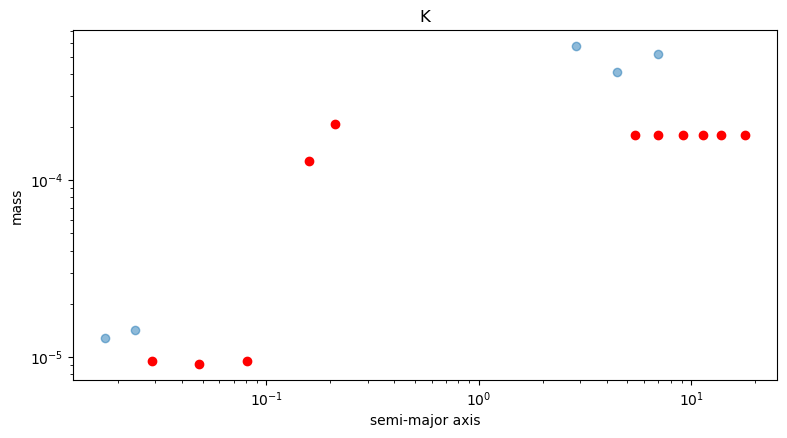

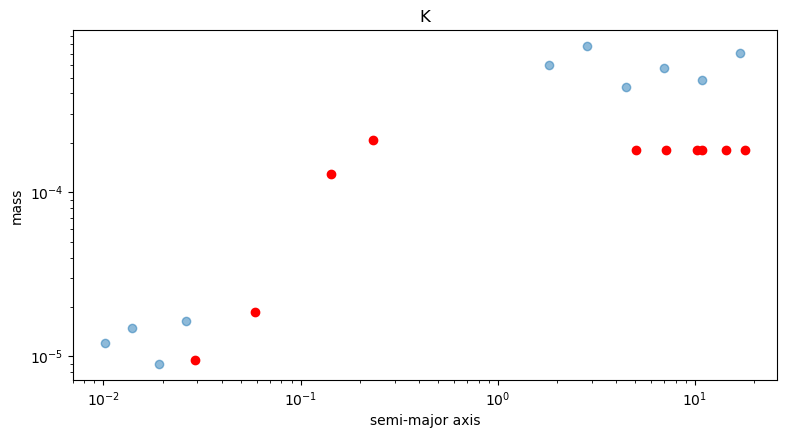

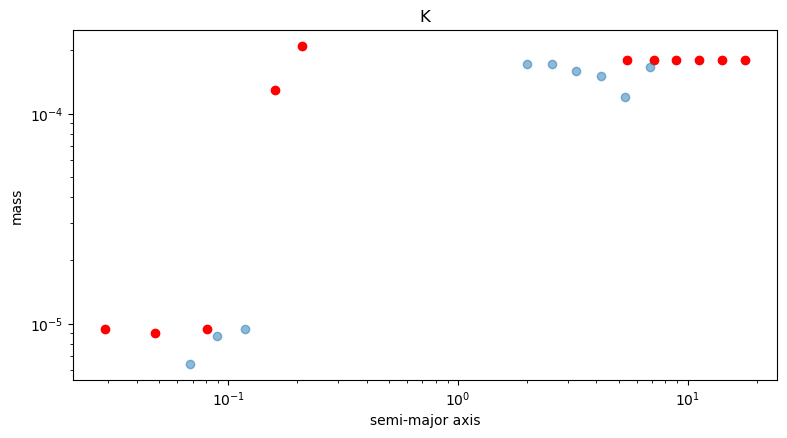

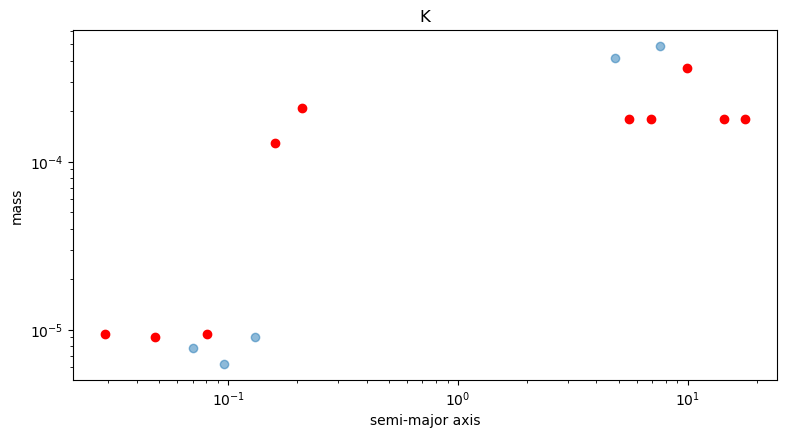

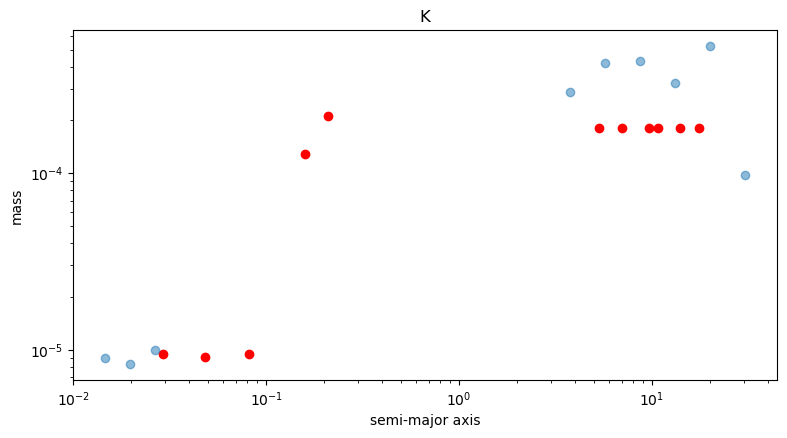

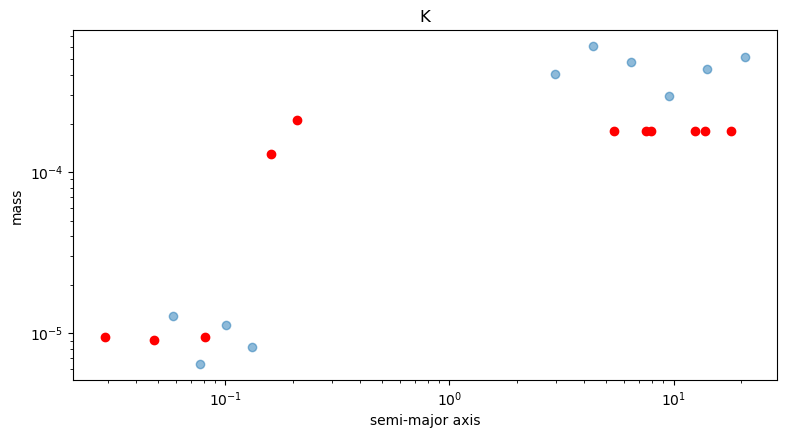

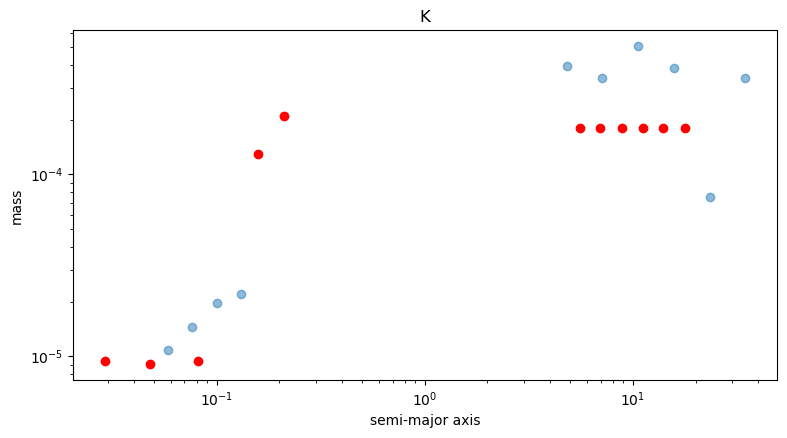

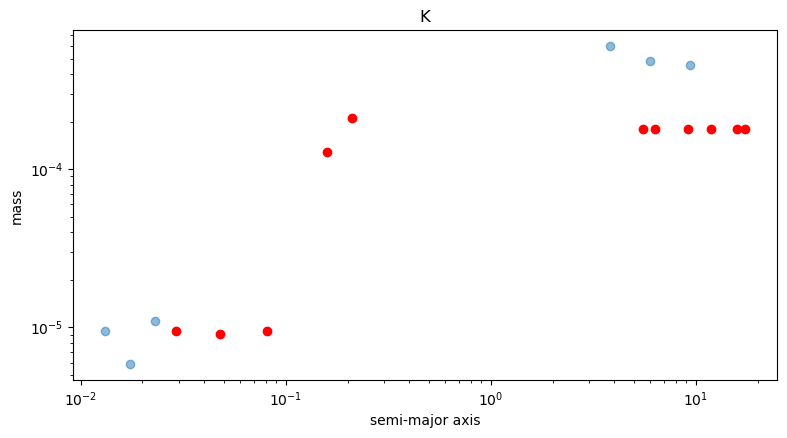

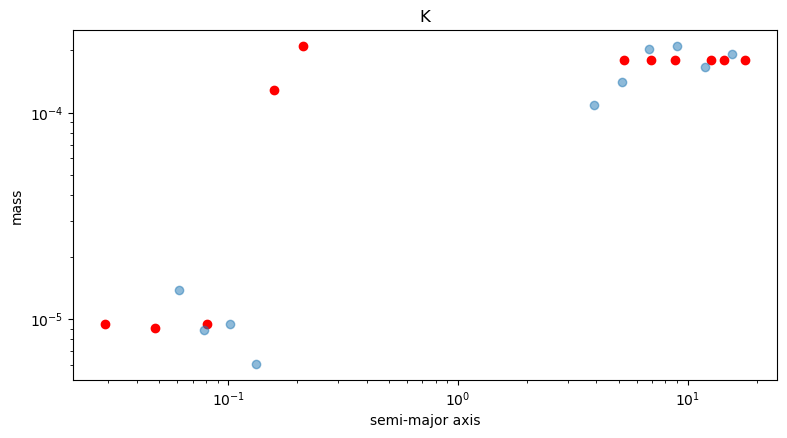

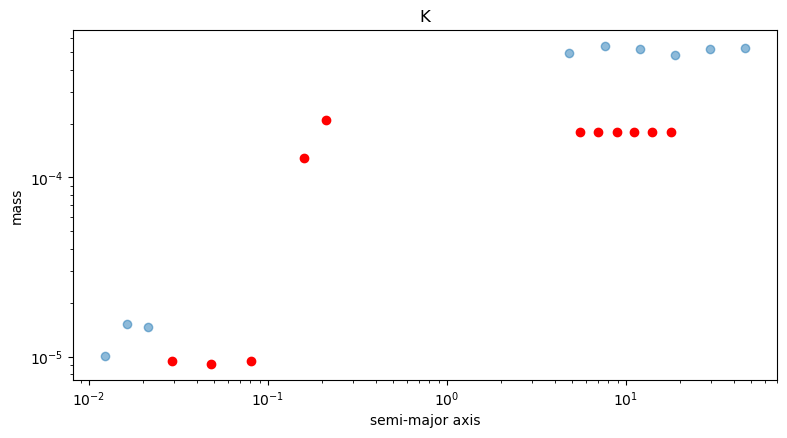

In [5]:
for p in range(10):
    globala = []
    globalm = []
    elm = random.choice(bee)
    for _ in range(1):
        in_random = random.choice(inner_templates)
        #print(in_random)
        out_random = random.choice(outer_templates)
        #print(out_random)
        sim = outer_template(inner_template(in_random[0], in_random[1], in_random[2]), out_random[0], out_random[1], out_random[2])
    fig = plt.figure(figsize=(20,10))
    ax = plt.subplot(221)
    ax.set_xlabel("semi-major axis")
    ax.set_ylabel("mass")
    ax.set_title("K")
    ax.set_yscale("log")
    ax.set_xscale("log")
    #plt.xlim(0, 2000)
    #print(times)
    count = 1
    for i in elm.keys():
        plt.scatter(elm[i][0][1][0], elm[i][0][4][0], label = "Planet " + str(count), color = 'r')
        count += 1
    #plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)

    plt.scatter(globala, globalm, alpha = 0.5)
    #plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)
    #print("bob)")

In [36]:
print(len(bee))
print(bee[0])
print(np.linspace(0, 10000000, 1000))

21
{3398275494: [array([[1.00000001e+04, 2.00000002e+04, 3.00000003e+04, ...,
        9.97000010e+06, 9.98000010e+06, 9.99000010e+06],
       [2.89996541e-02, 2.89997191e-02, 2.90005506e-02, ...,
        2.90001349e-02, 2.90002871e-02, 2.89994841e-02],
       [5.79070587e-02, 5.74409661e-02, 3.98768903e-02, ...,
        7.69726249e-02, 6.36087540e-02, 3.45952272e-02],
       [4.88669783e-02, 3.35109940e-02, 3.27945499e-02, ...,
        5.90414957e-01, 5.58121134e-01, 5.93102520e-01],
       [9.45771224e-06, 9.45771224e-06, 9.45771224e-06, ...,
        9.45771224e-06, 9.45771224e-06, 9.45771224e-06]]), True], 3655140575: [array([[1.00000001e+04, 2.00000002e+04, 3.00000003e+04, ...,
        9.97000010e+06, 9.98000010e+06, 9.99000010e+06],
       [4.80014112e-02, 4.80014329e-02, 4.79990457e-02, ...,
        4.79985885e-02, 4.79976659e-02, 4.80012600e-02],
       [5.00490104e-02, 5.72521396e-02, 6.07452906e-02, ...,
        3.11541540e-02, 4.15673366e-02, 4.55859655e-02],
       [2.2973515

bob)


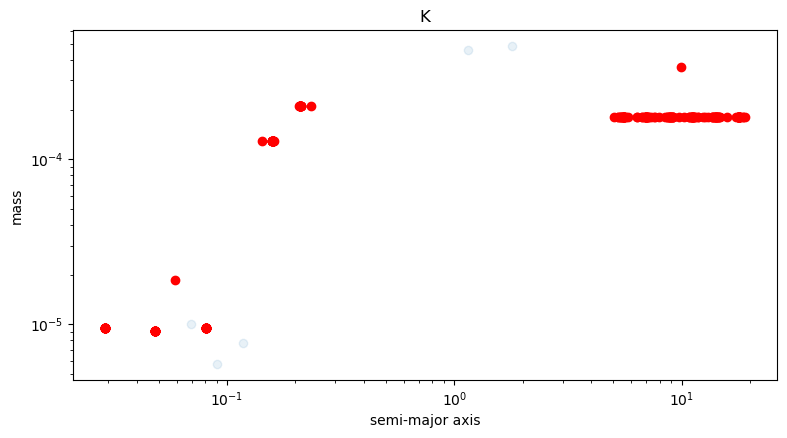

In [38]:
fig = plt.figure(figsize=(20,10))
ax = plt.subplot(221)
ax.set_xlabel("semi-major axis")
ax.set_ylabel("mass")
ax.set_title("K")
ax.set_yscale("log")
ax.set_xscale("log")
for elm in bee:
    #plt.xlim(0, 2000)
    #print(times)
    count = 1
    for i in elm.keys():
        plt.scatter(elm[i][0][1][0], elm[i][0][4][0], label = "Planet " + str(count), color = 'r')
        count += 1
    #plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)
    
plt.scatter(globala, globalm, alpha = 0.1)
#plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)
print("bob)")

/tmp/ipykernel_174/1952492578.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(20,10))


bob)


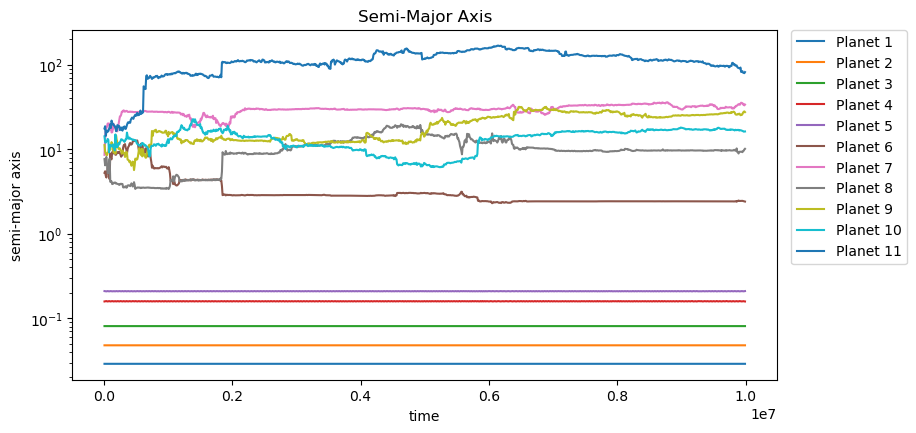

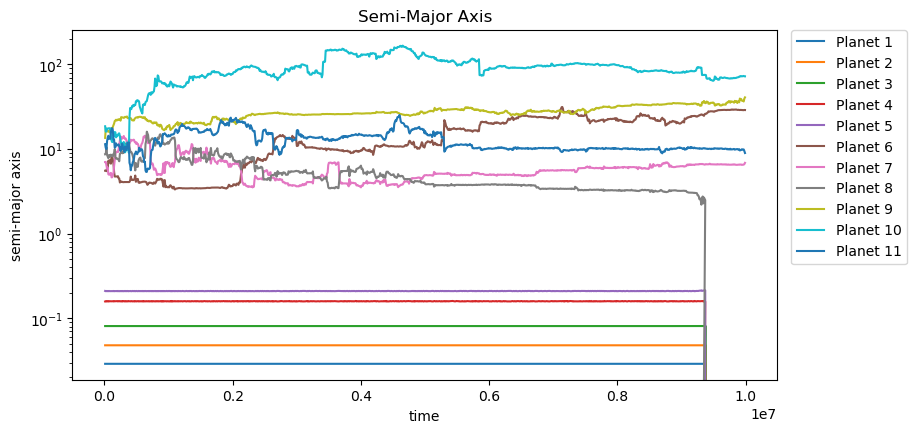

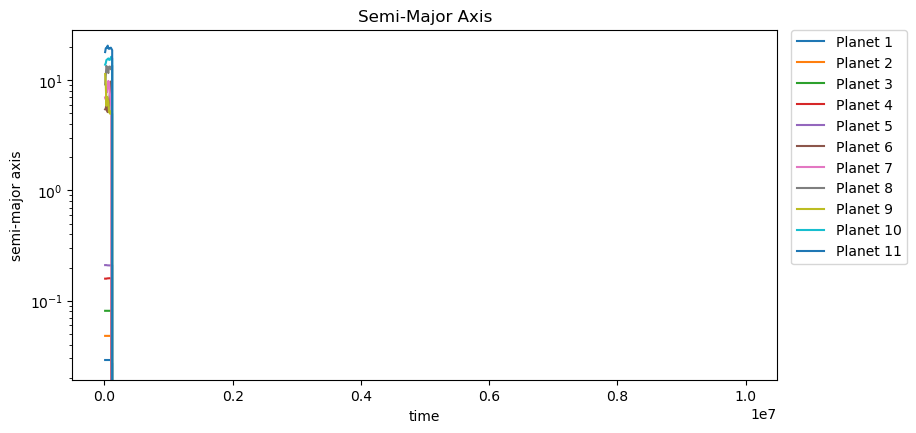

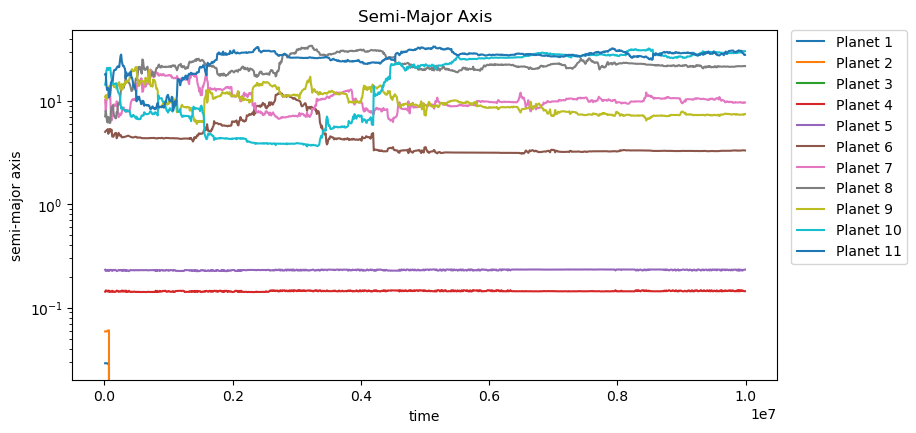

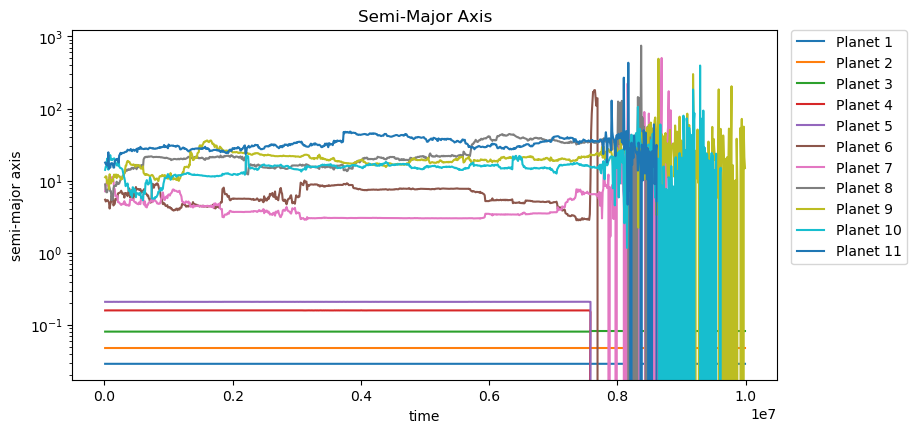

...

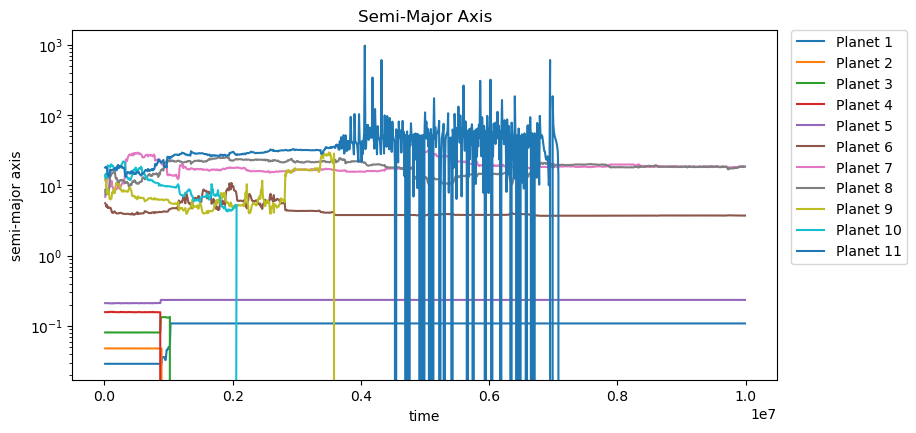

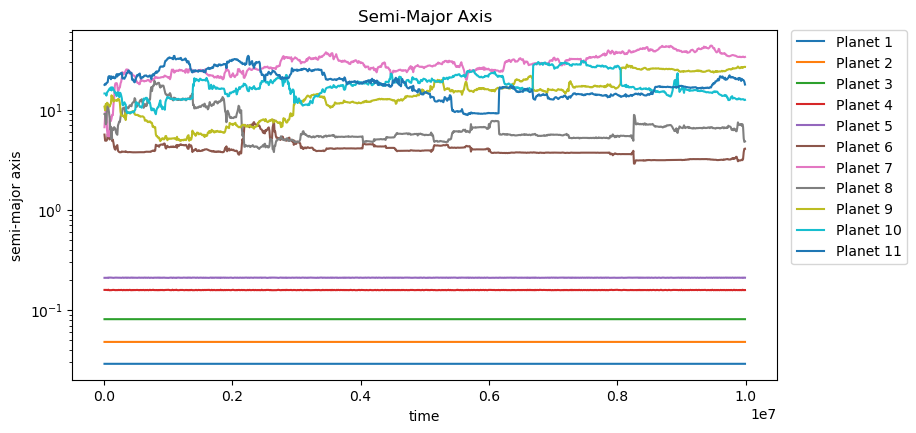

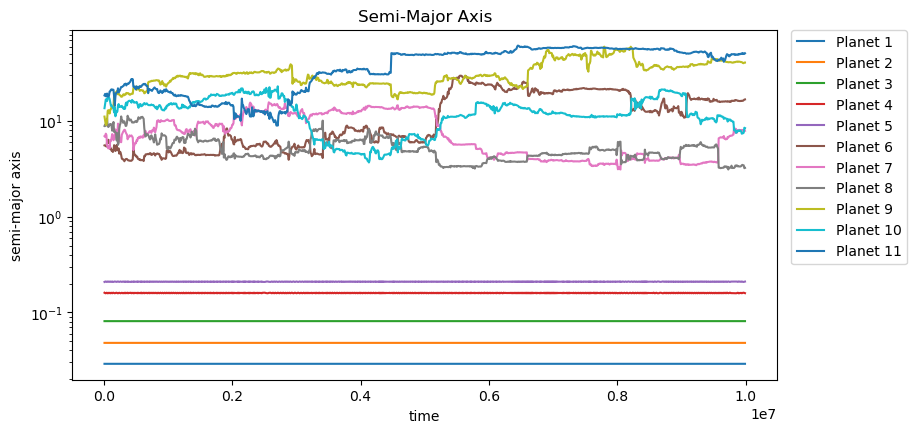

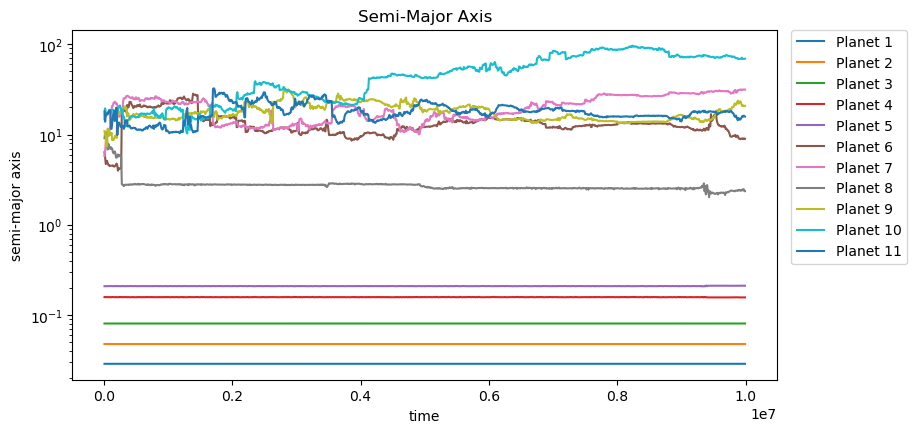

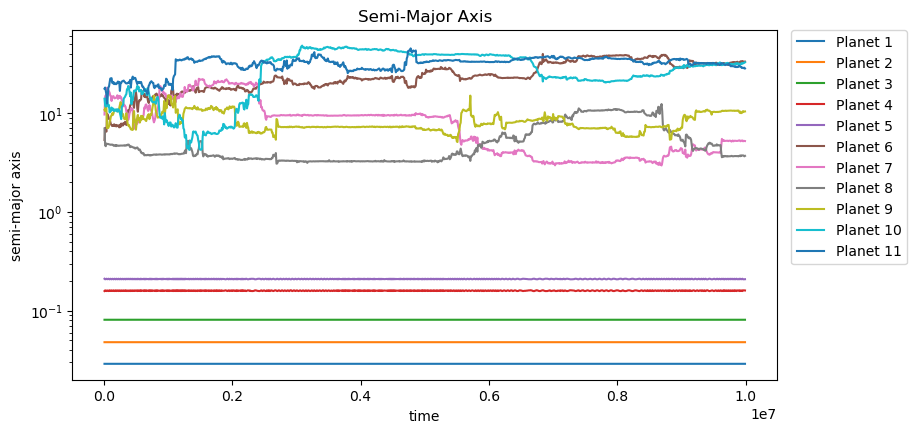

In [30]:
for elm in bee:
    fig = plt.figure(figsize=(20,10))
    ax = plt.subplot(221)
    ax.set_xlabel("time")
    ax.set_ylabel("semi-major axis")
    ax.set_title("Semi-Major Axis")
    ax.set_yscale("log")
    #plt.xlim(0, 2000)
    #print(times)
    count = 1
    for i in elm.keys():
        plt.plot(elm[i][0][0], elm[i][0][1], label = "Planet " + str(count))
        count += 1
    plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)
print("bob)")

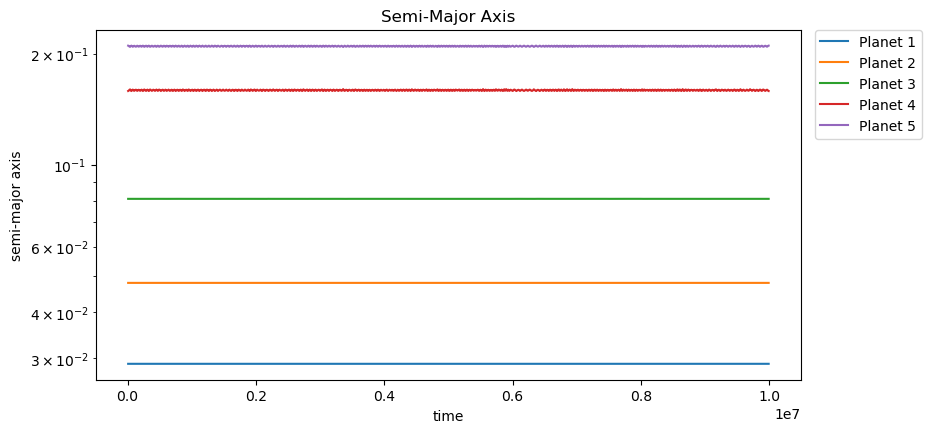

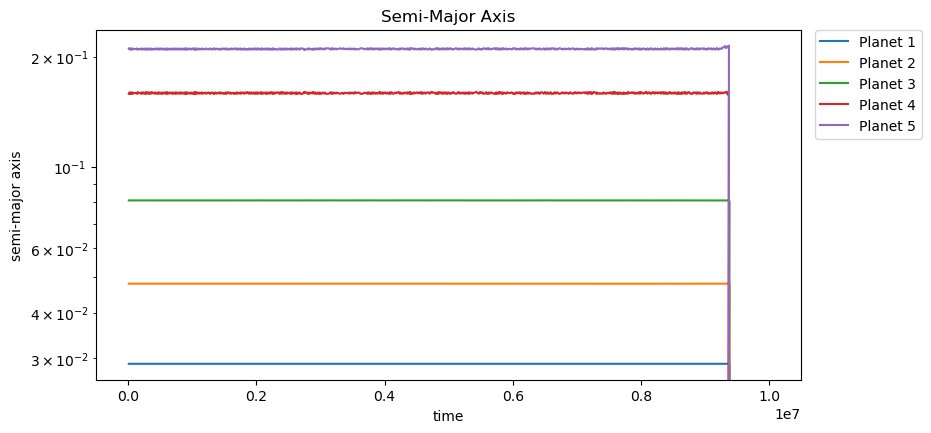

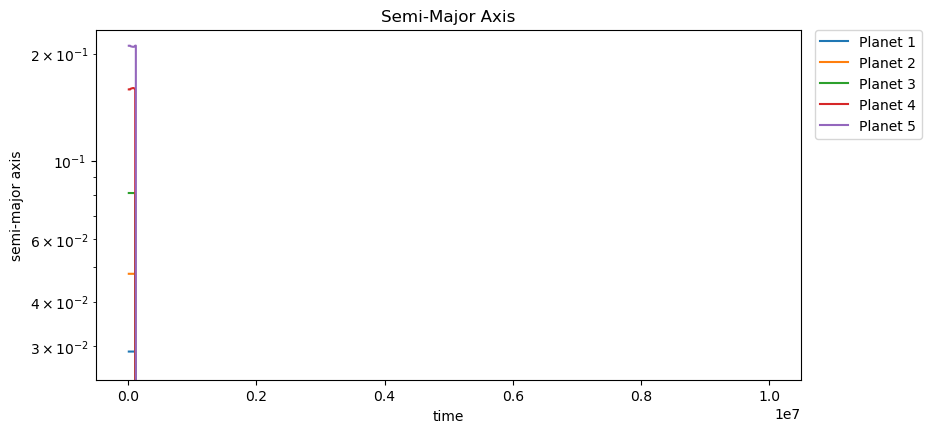

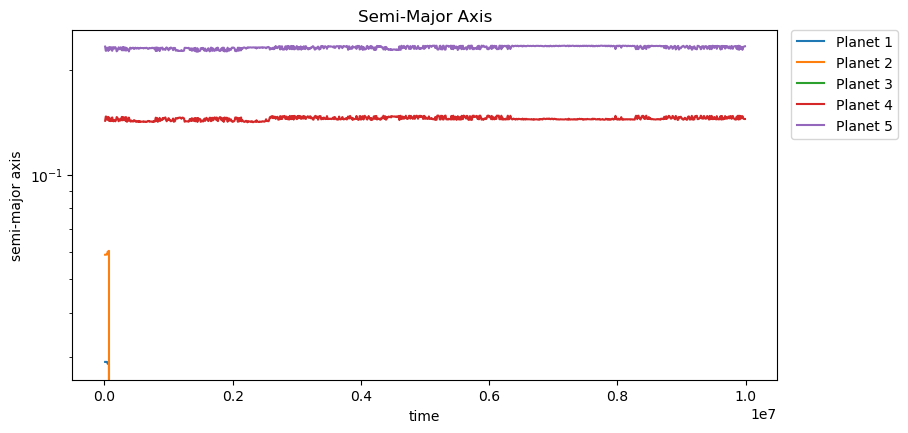

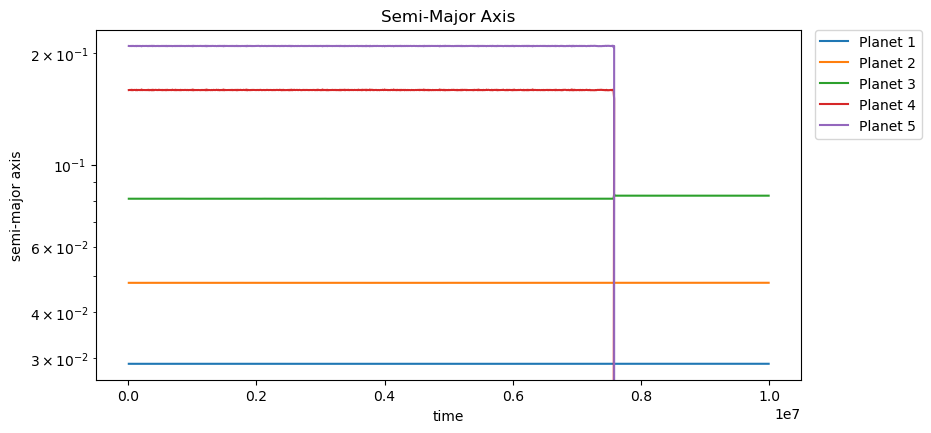

...

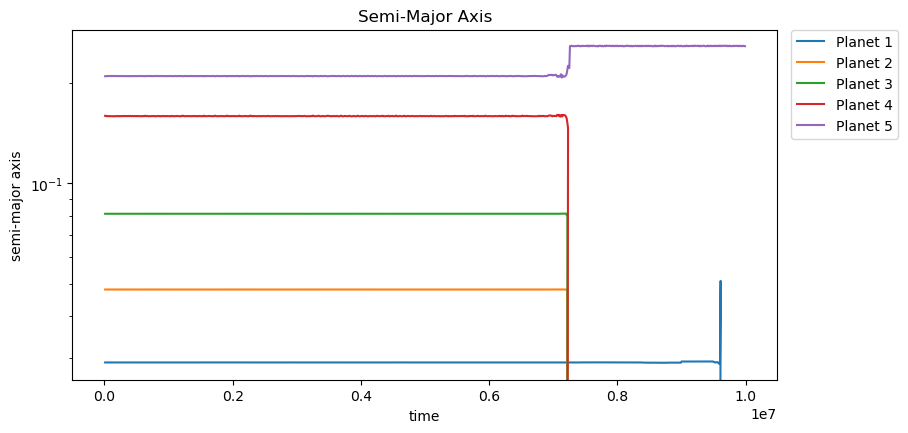

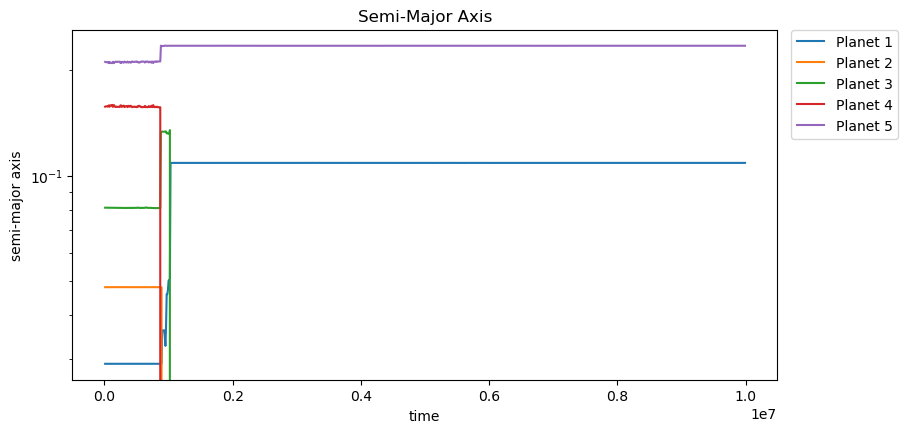

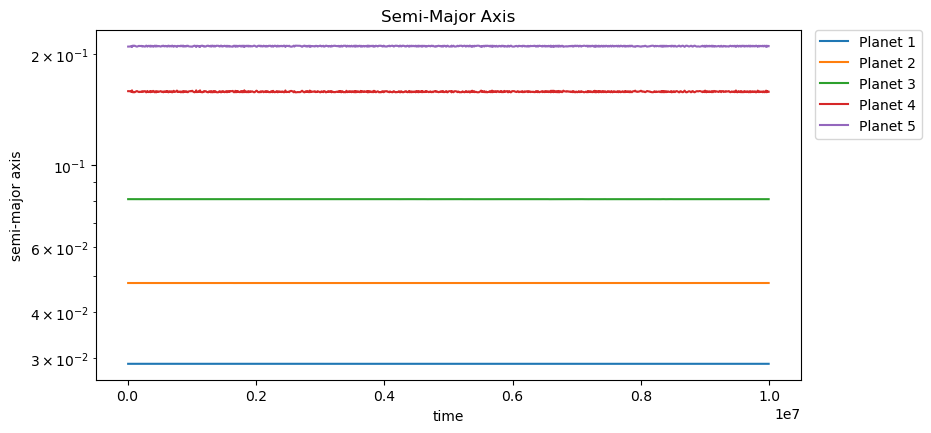

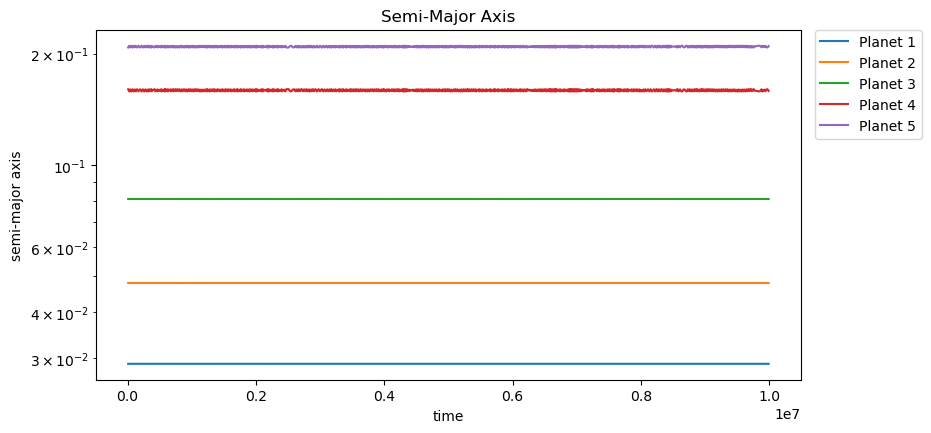

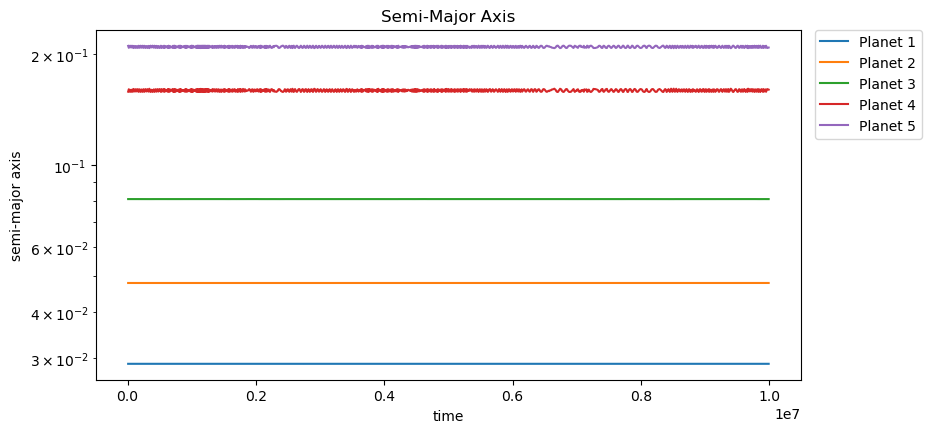

In [5]:
# integrationtime = 10000000
# time_between_outputs = 0.1
# n_between_writeouts = int((integrationtime / time_between_outputs) / 1000)
# Noutputs = int(integrationtime / time_between_outputs)
# times = np.linspace(0, integrationtime, Noutputs)
for elm in bee:
    fig = plt.figure(figsize=(20,10))
    ax = plt.subplot(221)
    ax.set_xlabel("time")
    ax.set_ylabel("semi-major axis")
    ax.set_title("Semi-Major Axis")
    ax.set_yscale("log")
    #plt.xlim(0, 2000)
    #print(times)
    count = 1
    for i in elm.keys():
        if count < 6:
            plt.plot(elm[i][0][0], elm[i][0][1], label = "Planet " + str(count))
        count += 1
    plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)

In [14]:
print(5/79)
print(12/79)
print(4/79)
print(3/79)
print(1/79)
print(54/79)

0.06329113924050633
0.1518987341772152
0.05063291139240506
0.0379746835443038
0.012658227848101266
0.6835443037974683


/tmp/ipykernel_2449/1897572535.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(20,10))


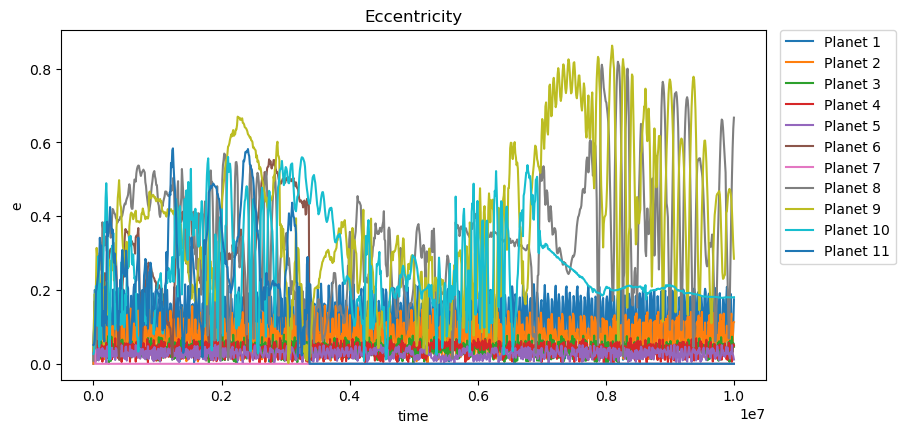

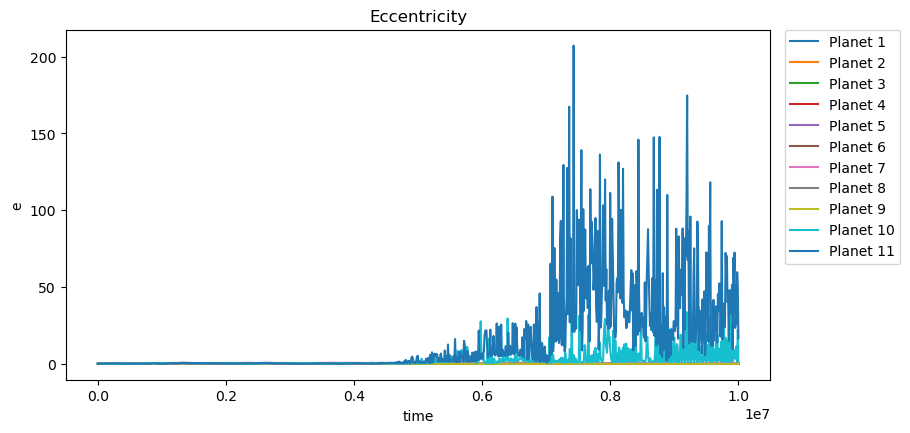

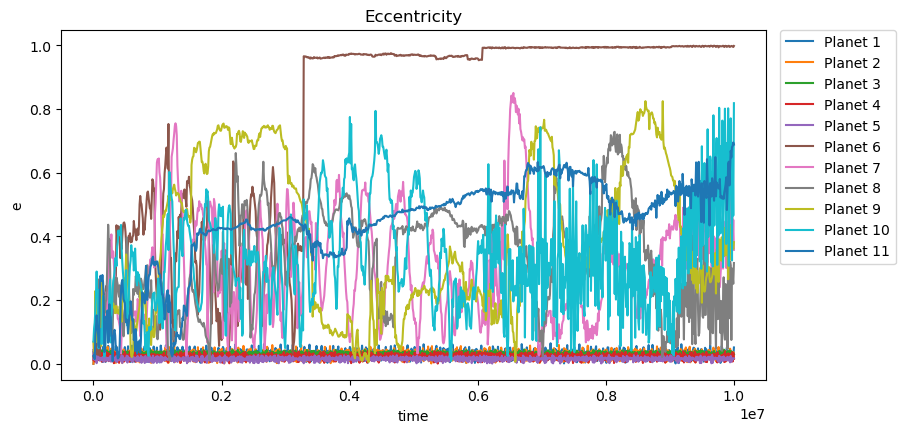

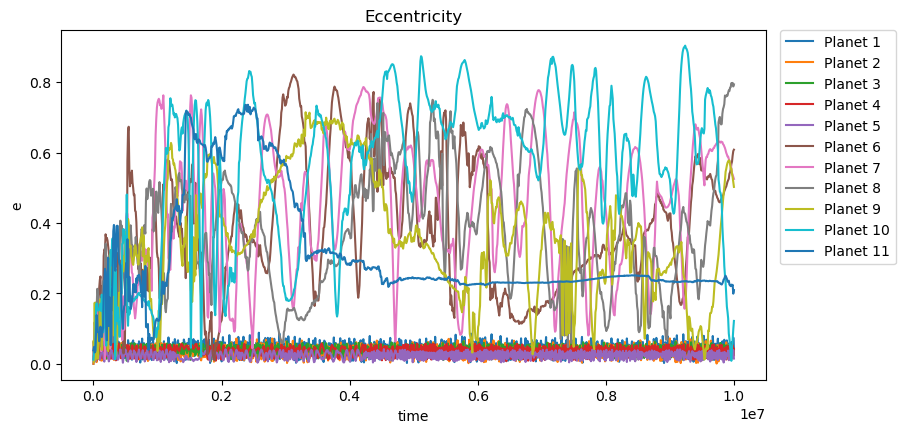

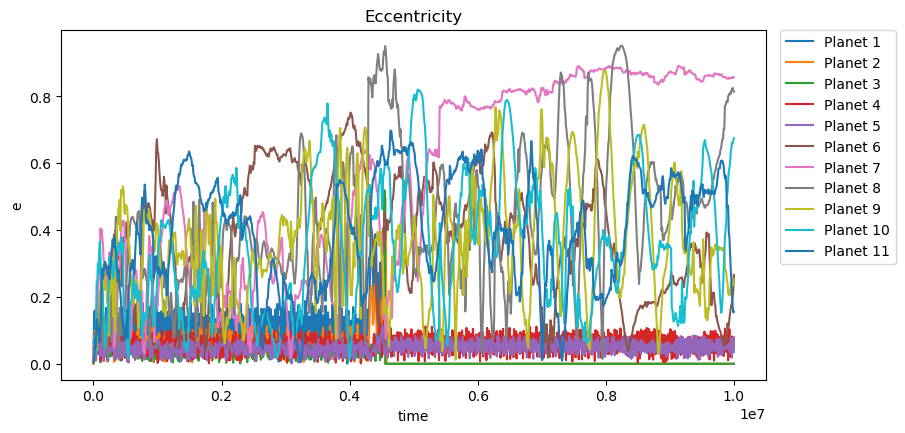

...

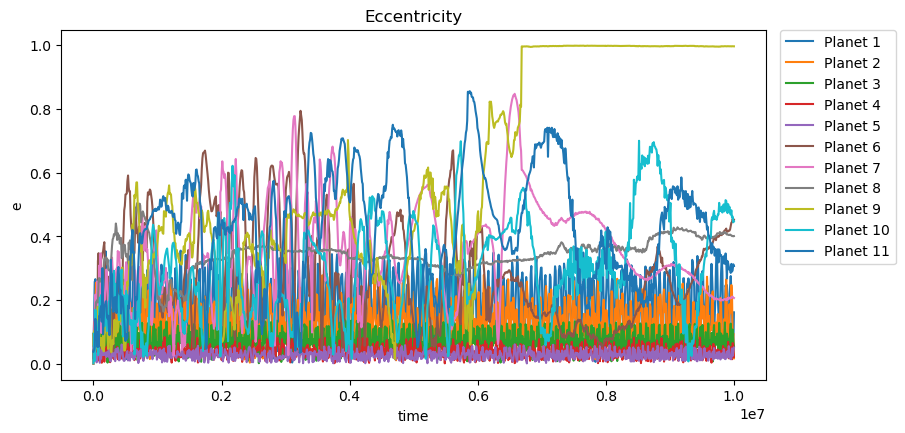

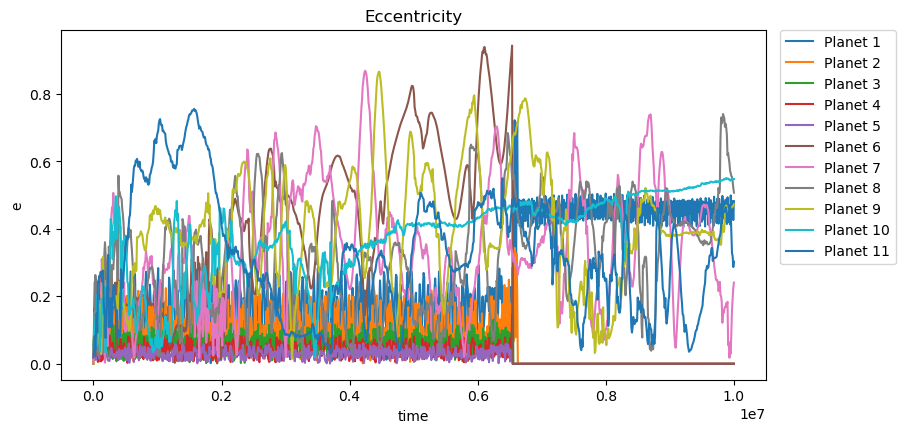

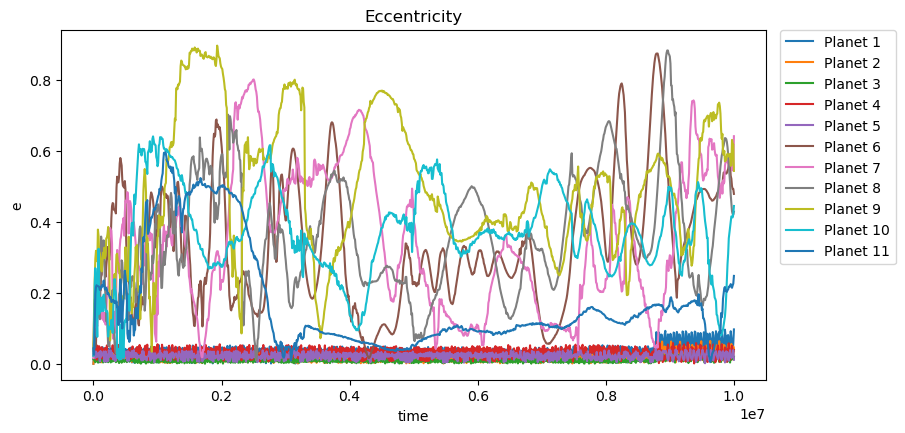

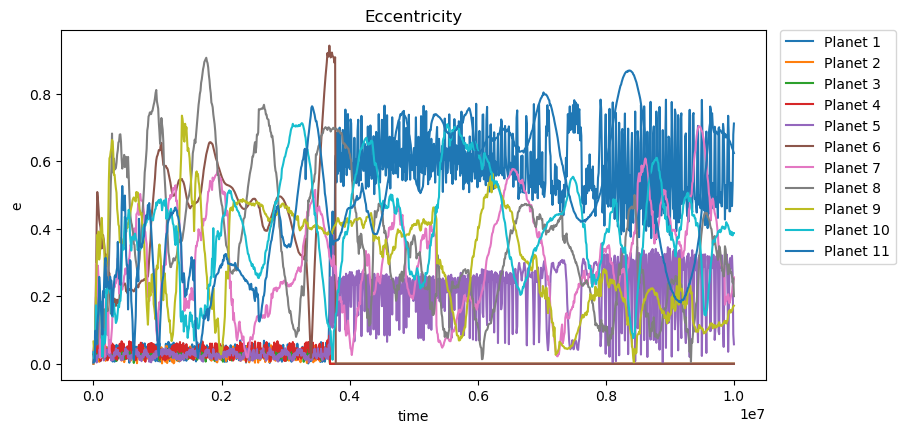

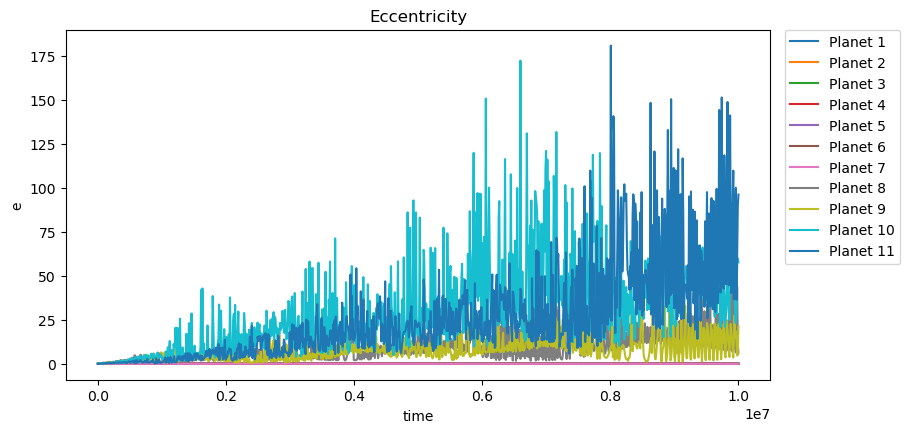

In [8]:
integrationtime = 10000000
time_between_outputs = 10000
Noutputs = int(integrationtime / time_between_outputs)
times = np.linspace(0, integrationtime, Noutputs)
for elm in bee:
    fig = plt.figure(figsize=(20,10))
    ax = plt.subplot(221)
    ax.set_xlabel("time")
    ax.set_ylabel("e")
    ax.set_title("Eccentricity")
    #ax.set_yscale("log")
    #plt.xlim(0, 2000)
    #print(times)
    count = 1
    for i in elm.keys():
        plt.plot(times, elm[i][0][2], label = "Planet " + str(count))
        count += 1
    plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)

/tmp/ipykernel_2291/4263511951.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(20,10))


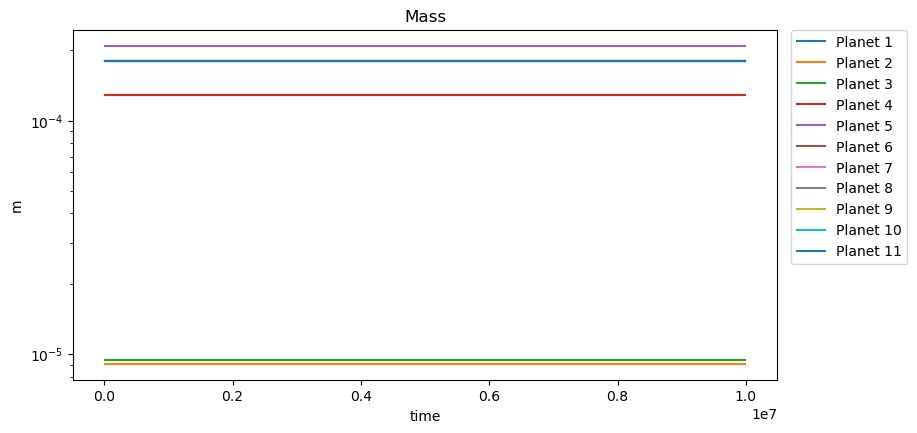

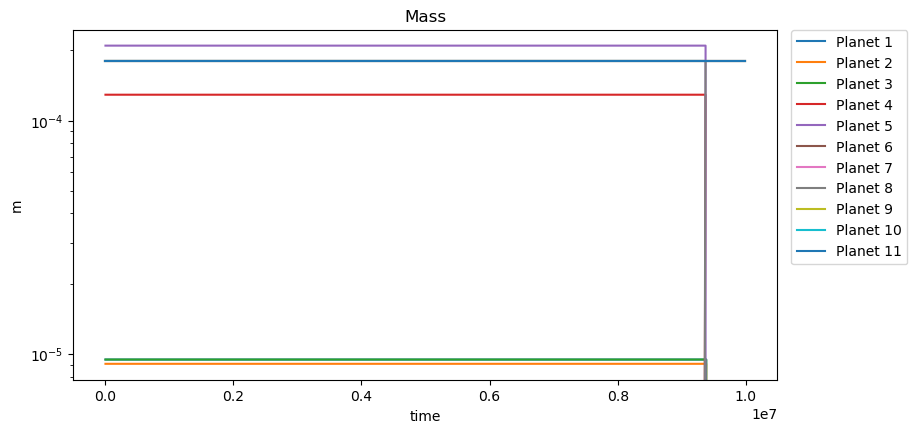

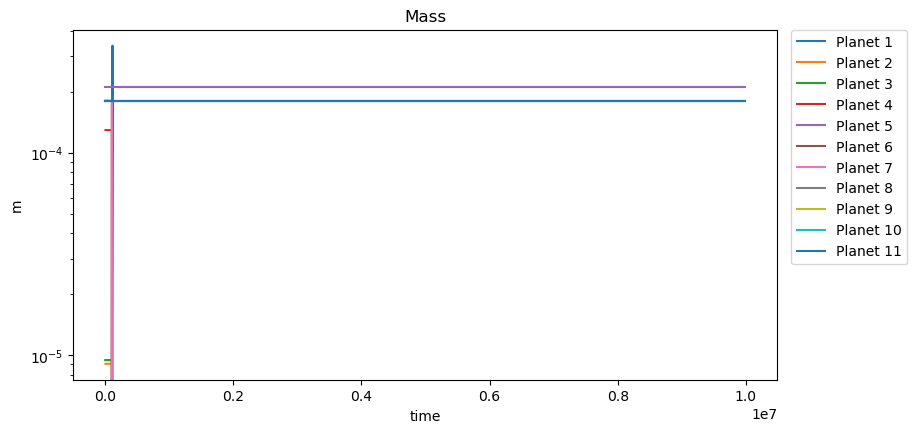

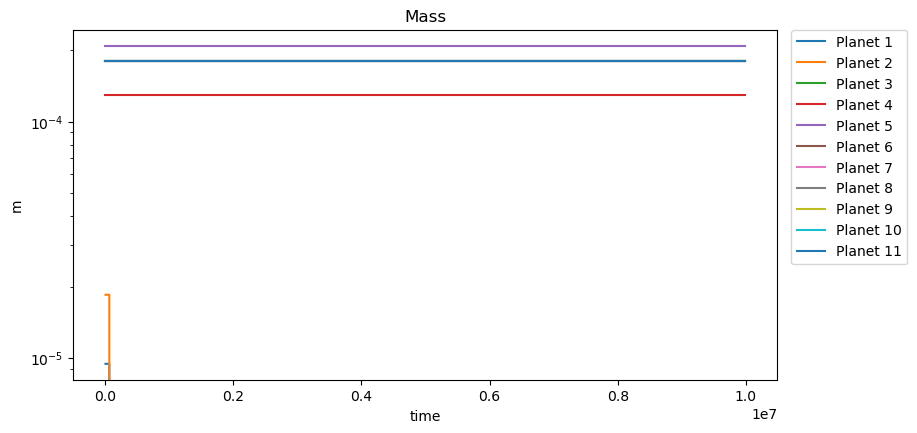

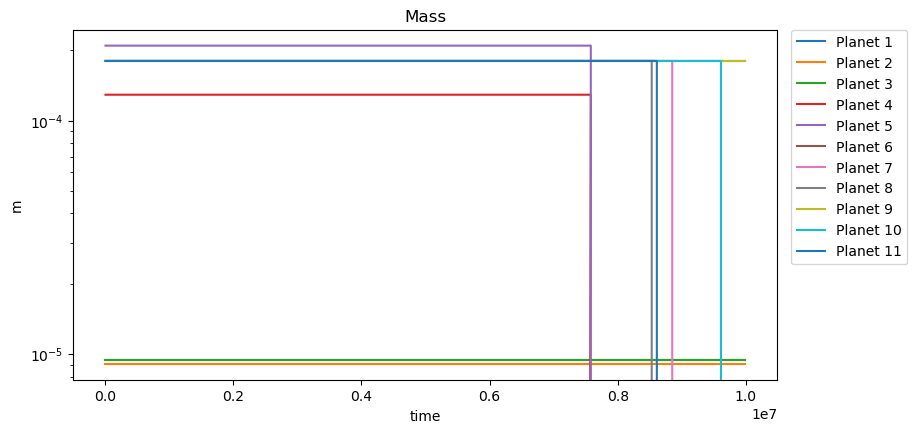

...

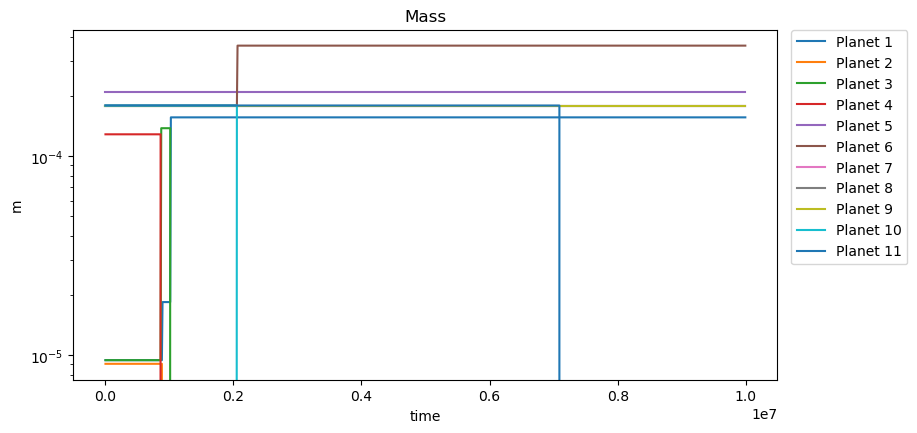

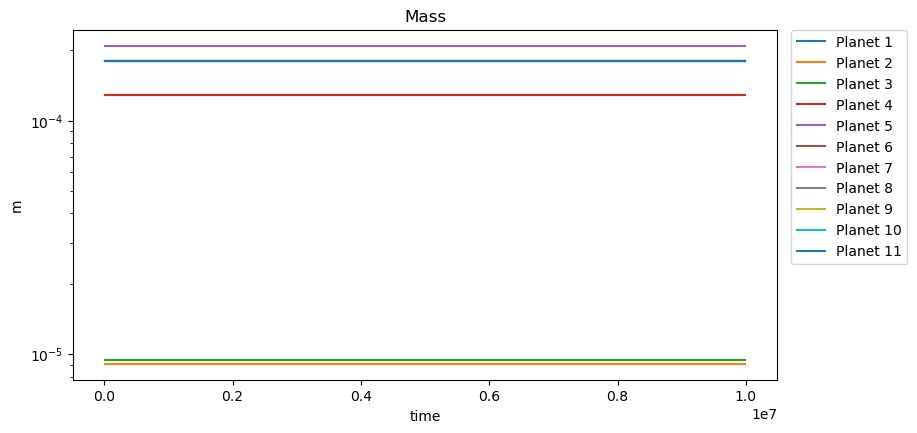

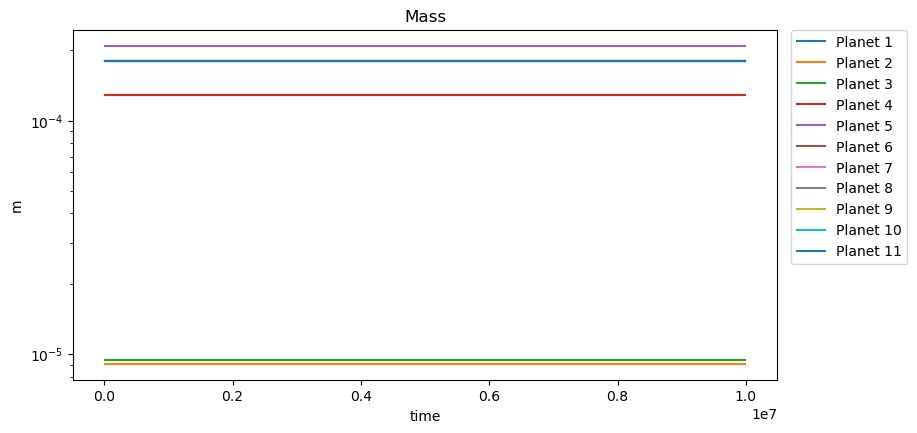

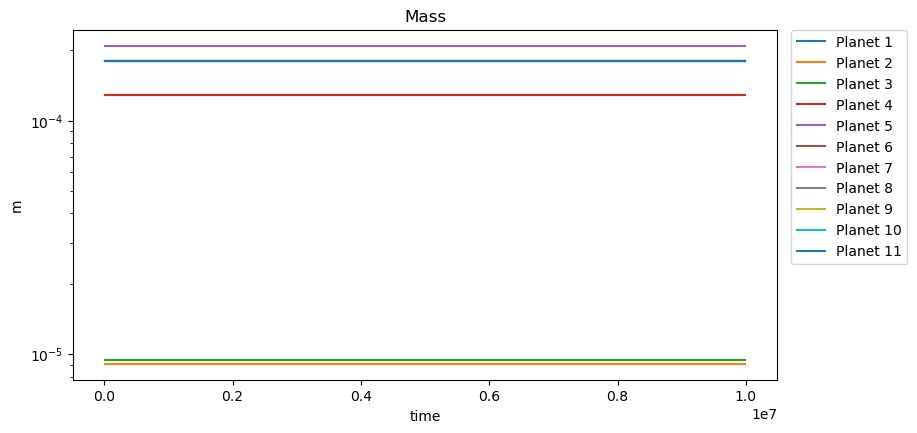

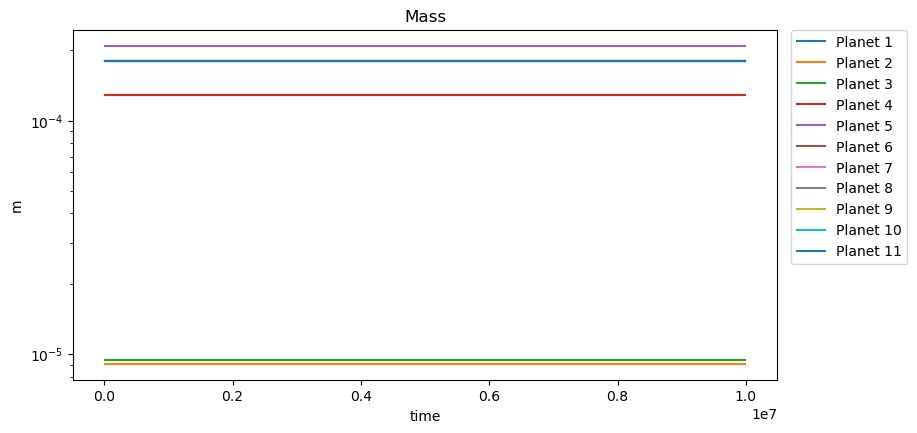

In [21]:
integrationtime = 10000000
time_between_outputs = 10000
Noutputs = int(integrationtime / time_between_outputs)
times = np.linspace(0, integrationtime, Noutputs)

for elm in bee:
    total_m_initial = 0
    fig = plt.figure(figsize=(20,10))
    ax = plt.subplot(221)
    ax.set_xlabel("time")
    ax.set_ylabel("m")
    ax.set_title("Mass")
    ax.set_yscale("log")
    #plt.xlim(0, 2000)
    #print(times)
    count = 1
    for i in elm.keys():
       
        plt.plot(elm[i][0][0], elm[i][0][4], label = "Planet " + str(count))
        count += 1
    plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)

In [18]:
for elm in bee:
    print(elm)
    total_m_initial = 0
    total_m_final = 0
    for i in elm.keys():
        #print(i)
        total_m_initial += elm[i][0][4][0]
        total_m_final += elm[i][0][4][-1]
    print(total_m_initial)
    print(total_m_final)
    print(" ")

{3398275494: [array([[1.00000001e+04, 2.00000002e+04, 3.00000003e+04, ...,
        9.97000010e+06, 9.98000010e+06, 9.99000010e+06],
       [2.89996541e-02, 2.89997191e-02, 2.90005506e-02, ...,
        2.90001349e-02, 2.90002871e-02, 2.89994841e-02],
       [5.79070587e-02, 5.74409661e-02, 3.98768903e-02, ...,
        7.69726249e-02, 6.36087540e-02, 3.45952272e-02],
       [4.88669783e-02, 3.35109940e-02, 3.27945499e-02, ...,
        5.90414957e-01, 5.58121134e-01, 5.93102520e-01],
       [9.45771224e-06, 9.45771224e-06, 9.45771224e-06, ...,
        9.45771224e-06, 9.45771224e-06, 9.45771224e-06]]), True], 3655140575: [array([[1.00000001e+04, 2.00000002e+04, 3.00000003e+04, ...,
        9.97000010e+06, 9.98000010e+06, 9.99000010e+06],
       [4.80014112e-02, 4.80014329e-02, 4.79990457e-02, ...,
        4.79985885e-02, 4.79976659e-02, 4.80012600e-02],
       [5.00490104e-02, 5.72521396e-02, 6.07452906e-02, ...,
        3.11541540e-02, 4.15673366e-02, 4.55859655e-02],
       [2.29735150e-